## Import libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import re as re
from geopy.geocoders import Nominatim

## Import dataset / first look at data

In [4]:
# immoscout = pd.read_csv(
#     './data/immoscout_cleaned_lat_lon_fixed_v9.csv',
#     index_col=[0]
#     )
# immoscout.head(4)

df = pd.read_csv('./data/immo_data_202208_v2.csv', index_col=[0])

immoscout = df[df.provider == "Immoscout24.ch"]
homegate = df[df.provider == "homegate.ch"]

immoscout.head(4)

C:\Users\rami0\AppData\Local\Temp\ipykernel_34416\168999765.py:7: DtypeWarning: Columns (3,4,5,6,11,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,45,46,47,49,50,107,110,114,115,116,119,120,121,124,125,126,128,131,132) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('./data/immo_data_202208_v2.csv', index_col=[0])


,Unnamed: 0,Municipality,Living space,Plot area,Floor space,Availability,location,description,detailed_description,url,...,features,description_detailed,Floor space:,Number of floors:,Volume:,plz,Number of toilets:,Gross yield:,Minimum floor space:,space_cleaned
0,0,Biberstein,100 m²,NaN,NaN,On request,"5023 Biberstein, AG","3.5 rooms, 100 m²«Luxuriöse Attika-Wohnung mit...",DescriptionLuxuriöse Attika-Wohnung direkt an ...,https://www.immoscout24.ch//en/d/penthouse-buy...,...,NaN,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN
1,1,Biberstein,156 m²,222 m²,242 m²,On request,"Buhldenstrasse 8d5023 Biberstein, AG","4.5 rooms, 156 m²«Stilvolle Liegenschaft - ruh...",DescriptionStilvolle Liegenschaft an ruhiger L...,https://www.immoscout24.ch//en/d/terrace-house...,...,NaN,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN
2,2,NaN,NaN,NaN,NaN,NaN,"5022 Rombach, AG","2.5 rooms, 93 m²«Moderne, lichtdurchflutete At...","detail_responsive#description_title2,5 Zimmerw...",https://www.immoscout24.ch//en/d/penthouse-buy...,...,NaN,NaN,NaN,NaN,NaN,5022.0,NaN,NaN,NaN,NaN
3,3,Biberstein,154 m²,370 m²,257 m²,On request,"Buhaldenstrasse 8A5023 Biberstein, AG","4.5 rooms, 154 m²«AgentSelly - Luxuriöses Eckh...",DescriptionDieses äusserst grosszügige Minergi...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN


In [3]:
# immoscout.query('details has "')

# immoscout.filter(items='details', like='m²', axis=0)

# immoscout.loc[immoscout['details'].notna().str.contains("m²")]

# df.nunique()['provider']

## EDA - Profiling

In [4]:
## replace na
immoscout = immoscout.replace('NaN', np.nan)
homegate = homegate.replace("NaN", np.nan)

## rename
immoscout = immoscout.rename( columns={
    'Living space': 'Living_space',
    'Floor space': 'Floor_space',
    'Plot area': 'Plot_area'
})

# homegate = homegate.rename(columns={
#     'Surface_living:': 'Living_space',
#     'No. of rooms:': 'No_of_rooms',
#     ''
# })

In [5]:
## get correct rooms
immoscout.rooms = (
    immoscout.description.str.findall('^[0-9]?[0-9]?\.?[0-9]?\s?rooms?')
    .apply(lambda x: x[0] if len(x)>0 else np.nan)
    .str.extract('(\d+.?\d?)')
    .astype('float')
)

## Rooms in homegate data set are already clean

In [6]:
# transform livingspace type
immoscout['living_space_cleaned'] = immoscout.Living_space_merged.str.extract('(\d+)')
immoscout.living_space_cleaned = immoscout.living_space_cleaned.astype('float')
immoscout.price_cleaned = immoscout.price_cleaned.astype('float')
immoscout = immoscout.fillna(np.nan)

# transform living space and price homegate
homegate['Surface living:']

13355    275 m2
13356    106 m2
13357    100 m2
13358     52 m2
13359     61 m2
          ...  
22476    102 m2
22477    250 m2
22478    240 m2
22479    175 m2
22480    220 m2
Name: Surface living:, Length: 9126, dtype: object

In [7]:
## parse floors
immoscout.Floor = immoscout.Floor.replace({
    '4. Basement': -4,
    '3. Basement': -3,
    '2. Basement': -2,
    '1. Basement': -1,
    'Ground floor': 0,
    '1. floor': 1,
    '2. floor': 2,
    '3. floor': 3,
    '4. floor': 4,
    '5. floor': 5,
    '6. floor': 6,
    '7. floor': 7,
    '8. floor': 8,
    '9. floor': 9,
    '10. floor': 10,
    '11. floor': 11,
    '12. floor': 12,
    '13. floor': 13,
    '14. floor': 14,
    '15. floor': 15,
    '16. floor': 16,
    '17. floor': 17,
    '18. floor': 18,
    '19. floor': 19,
    '20. floor': 20,
    '21. floor': 21,
    '22. floor': 22,
    '23. floor': 23,
    '100. floor': np.nan,
    '999. floor': np.nan,
    'nan': np.nan
})

# Homegate No_of_rooms already clean

## parse floors
immoscout.Floor_merged = immoscout.Floor_merged.replace({
    '4. Basement': -4,
    '3. Basement': -3,
    '2. Basement': -2,
    '1. Basement': -1,
    'Ground floor': 0,
    '1. floor': 1,
    '2. floor': 2,
    '3. floor': 3,
    '4. floor': 4,
    '5. floor': 5,
    '6. floor': 6,
    '7. floor': 7,
    '8. floor': 8,
    '9. floor': 9,
    '10. floor': 10,
    '11. floor': 11,
    '12. floor': 12,
    '13. floor': 13,
    '14. floor': 14,
    '15. floor': 15,
    '16. floor': 16,
    '17. floor': 17,
    '18. floor': 18,
    '19. floor': 19,
    '20. floor': 20,
    '21. floor': 21,
    '22. floor': 22,
    '23. floor': 23,
    '100. floor': np.nan,
    '999. floor': np.nan,
    'nan': np.nan
})

In [8]:
immoscout.query('Floor != Floor_merged and Floor.notna() and Floor_merged.notna()', engine='python')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,description_detailed,Floor space:,Number of floors:,Volume:,plz,Number of toilets:,Gross yield:,Minimum floor space:,space_cleaned,living_space_cleaned


In [9]:
immoscout.query('Living_space != Living_space_merged and Living_space.notna() and Living_space_merged.notna()', engine='python')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,description_detailed,Floor space:,Number of floors:,Volume:,plz,Number of toilets:,Gross yield:,Minimum floor space:,space_cleaned,living_space_cleaned


In [10]:
immoscout.query('Floor_space != Floor_space_merged and Floor_space.notna() and Floor_space_merged.notna()', engine='python')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,description_detailed,Floor space:,Number of floors:,Volume:,plz,Number of toilets:,Gross yield:,Minimum floor space:,space_cleaned,living_space_cleaned


In [11]:
immoscout.query('Plot_area != Plot_area_merged and Plot_area.notna() and Plot_area_merged.notna()', engine='python')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,description_detailed,Floor space:,Number of floors:,Volume:,plz,Number of toilets:,Gross yield:,Minimum floor space:,space_cleaned,living_space_cleaned


In [28]:
def extract_value(x):
    try:
        return x[0]
    except:
        return np.nan

immoscout['canton'] = immoscout.location_parsed.str.findall('(?<=Kanton:\s).*').apply(lambda x:extract_value(x))
immoscout['ZIP'] = immoscout.location_parsed.str.findall('(?<=plz:).*(?=\sStadt:\s)').apply(lambda x:extract_value(x))
immoscout['city'] = immoscout.location_parsed.str.findall('(?<=Stadt:\s).*(?=\sKanton:)').apply(lambda x:extract_value(x))
immoscout['street'] = immoscout.location_parsed.str.findall('(?<=Strasse:)[\w, \s]*(?=\s\s\d)').apply(lambda x:extract_value(x))
immoscout['house_nr'] = immoscout.location_parsed.str.findall('\d+.*(?=\splz:)').apply(lambda x:extract_value(x))


# Most of these return nan because the homegate dataset does not have all the data needed
homegate['canton'] = homegate.location_parsed.str.findall('(?<=Kanton:\s).*').apply(lambda x:extract_value(x))
homegate['ZIP'] = homegate.location_parsed.str.findall('(?<=plz:).*(?=\sStadt:\s)').apply(lambda x:extract_value(x))
homegate['city'] = homegate.location_parsed.str.findall('(?<=Stadt:\s).*(?=\sKanton:)').apply(lambda x:extract_value(x))
homegate['street'] = homegate.location_parsed.str.findall('(?<=Strasse:)[\w, \s]*(?=\s\s\d)').apply(lambda x:extract_value(x))
homegate['house_nr'] = homegate.location_parsed.str.findall('\d+.*(?=\splz:)').apply(lambda x:extract_value(x))

## New clean reduced dataset

In [27]:
immoscout_clean = immoscout[[
    'index',
    'description',
    'detailed_description',
    'price_cleaned',
    'rooms',
    'living_space_cleaned',
    'Floor_space_merged',
    'Plot_area_merged',
    'Floor_merged',
    'type',
    'lat',
    'lon',
    'canton',
    'ZIP',
    'city',
    'street',
    'house_nr'
]].copy()

homegate_clean = homegate[[
    'index',
    'description',
    'description_detailed',
    'price_cleaned',
    'No. of rooms:',
    'space_cleaned',
    'Plot_area_unified',
    'type',
    'lat',
    'lon',
    'canton',
    'ZIP',
    'city',
    'street',
    'house_nr'
]]

homegate_clean.head()

,index,description,description_detailed,price_cleaned,No. of rooms:,space_cleaned,Plot_area_unified,type,lat,lon,canton,ZIP,city,street,house_nr
13355,44558,"Cette maison, construite en 1914, est située d...","Description\n""Maison de maître composée de 3 a...",3500000.0,10.5,275.0,2879.0,Multi-family house,46.521827,6.632702,NaN,1000,NaN,NaN,NaN
13356,44558,"PROXIMMO, VOTRE AGENCE IMMOBILIÈRE À LAUSANNE ...","Description\n""A SAISIR ! EMPLACEMENT IDÉAL EN ...",995000.0,4.5,106.0,NaN,Apartment,46.521827,6.632702,NaN,1004,NaN,NaN,NaN
13357,44558,"Situé au coeur de Lausanne, dans un quartier p...","Description\n""VISITE VIRTUELLE : Exclusif au c...",935000.0,3.5,100.0,NaN,Apartment,46.521827,6.632702,NaN,1004,NaN,NaN,NaN
13358,44558,"Charmant appartement de 2,5 pièces avec un jol...","Description\n""Charmant appartement - joli pote...",640000.0,2.5,52.0,NaN,Apartment,46.521827,6.632702,NaN,1018,NaN,NaN,NaN
13359,44558,"Joli appartement de 3.5 pièces, d'une surface ...","Description\n""3.5 pièces au 2ème étage""\nJoli ...",730000.0,3.0,61.0,NaN,Apartment,46.521827,6.632702,NaN,1018,NaN,NaN,NaN


In [29]:
from pandas_profiling import ProfileReport

In [17]:
ProfileReport(immoscout_clean)

Render HTML: 100%|██████████| 1/1 [00:04<00:00,  4.25s/it]


In [30]:
ProfileReport(homegate_clean)

Render HTML: 100%|██████████| 1/1 [00:04<00:00,  4.12s/it]


In [480]:
# start profiling
immoscout_profile = {}

for i1, col_name in enumerate(immoscout_clean.columns): 
    
    immoscout_profile[F"{col_name}"] = {
        'col_type' : immoscout_clean.dtypes[i1],
        'unique_types' : pd.Series([type(e) for e in immoscout_clean[col_name]]).unique(),
        'nan-count' : immoscout_clean[col_name].isna().sum(),
        'nan-%': immoscout_clean[col_name].isna().sum() / (immoscout_clean[col_name].isna().sum() + immoscout_clean[col_name].notna().sum()) * 100,
        'notnan-count' : immoscout_clean[col_name].notna().sum(),
        '0-count' : (immoscout_clean[col_name] == 0).sum(),
        '0-%' : (immoscout_clean[col_name] == 0).sum() / (immoscout_clean[col_name].isna().sum() + immoscout_clean[col_name].notna().sum()) * 100,
        'negative-count' : 'nan',
        'negative-%' : 'nan',
        'unique-count' : immoscout_clean[col_name].nunique(),
        'unique-%' : immoscout_clean[col_name].nunique() / (immoscout_clean[col_name].isna().sum() + immoscout_clean[col_name].notna().sum()) * 100,
        'min-value' : 'nan',
        'max-value' : 'nan',
        'mean-value' : 'nan',
        'median-value' : 'nan',
        'standard-deviation' : 'nan',
        'correlates with' : 'nan',
        'top-outlier-count' : 'nan',
        'bottom-outlier-count' : 'nan',
        #'boxplot' : 'nan'
    }

# additional profiling for numbers
for i1, e1 in enumerate(immoscout_profile):
    if str not in immoscout_profile[e1]['unique_types']:            ## only dtype which causes trouble in df is str
        immoscout_profile[e1]['negative-count'] = (immoscout_clean[e1] < 0).sum()
        immoscout_profile[e1]['negative-%'] = (immoscout_clean[e1] < 0).sum() / len(immoscout_clean[e1])
        immoscout_profile[e1]['min-value'] = immoscout_clean[e1].min()
        immoscout_profile[e1]['max-value'] = immoscout_clean[e1].max()
        immoscout_profile[e1]['mean-value'] = immoscout_clean[e1].mean()
        immoscout_profile[e1]['median-value'] = immoscout_clean[e1].median()
        immoscout_profile[e1]['standard-deviation'] = immoscout_clean[e1].std()
        immoscout_profile[e1]['top-outlier-count'] = (immoscout_clean[e1] > immoscout_clean[e1].quantile(0.75) + 1.5 * (immoscout_clean[e1].quantile(0.75) - immoscout[e1].quantile(0.25))).sum()
        immoscout_profile[e1]['bottom-outlier-count'] = (immoscout_clean[e1] < immoscout_clean[e1].quantile(0.25) - 1.5 * (immoscout_clean[e1].quantile(0.75) - immoscout[e1].quantile(0.25))).sum()
        #immoscout_profile[e1]['boxplot'] = immoscout_clean[e1].plot.box()
        #immoscout_profile[e1]['correlates with'] = 'xxx'
        plt.close()

## modus pending...
## column plot for categorical pending...

## drop cols with >95% nan
#immoscout = immoscout.drop(columns =[e1 for i1, e1 in enumerate(immoscout_profile) if immoscout_profile[e1]['nan-%'] >= 95])

KeyError: 'df_index'

In [18]:
immoscout_profile_df = pd.DataFrame(immoscout_profile).T
immoscout_profile_df.head(20)

NameError: name 'immoscout_profile' is not defined

In [ ]:
immoscout_profile_df.to_csv('./profile.csv')

In [20]:
## get addresses from geopy

locator = Nominatim(user_agent='myGeocoder')

geopy_canton = []
geopy_zip = []
geopy_city = []
geopy_street = []
geopy_house_nr = []

for index, row in immoscout_clean.head(10).iterrows():
    try:
        print(row.lat, row.lon)
        location = locator.reverse(f"{row.lat}, {row.lon}").raw
        ## get state
        try:
            geopy_canton.append(location.raw['address']['state'])
        except:
            geopy_canton.append(np.nan)
        ## get zip
        try:
            geopy_zip.append(location.raw['address']['postcode'])
        except:
            geopy_zip.append(np.nan)
        ## get city
        try:
            geopy_city.append(location.raw['address']['city'])
        except:
            geopy_city.append(location.raw['address']['town'])
        ## get street
        try:
            geopy_street.append(location.raw['address']['road'])
        except:
            geopy_street.append(np.nan)
        ## get house nr
        try:
            geopy_house_nr.append(location.raw['address']['house_number'])
        except:
            geopy_house_nr.append(np.nan)

    except:
        geopy_canton.append(np.nan)
        geopy_zip.append(np.nan)
        geopy_city.append(np.nan)
        geopy_street.append(np.nan)
        geopy_house_nr.append(np.nan)

47.4171 8.0856
47.4195 8.0827
47.4033 8.033
47.415643 8.0854228
47.4038235 8.0482879
47.4009351 8.0124603
47.4140667 8.0821155
47.3927146 8.0444448
47.4011231 8.0706905
47.3968661 8.0133738


In [468]:
geopy_street

[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]

In [ ]:
immoscout_clean['geopy_canton'] = geopy_canton
immoscout_clean['geopy_zip'] = geopy_zip
immoscout_clean['geopy_city'] = geopy_city
immoscout_clean['geopy_street'] = geopy_street
immoscout_clean['geopy_house_nr'] = geopy_house_nr

## imputation????

#### Columns that have missing living/floor space data:
1. detail_responsive#surface_living
2. detail_responsive#surface_usable
3. Wohnflache
4. Nutzflache
5. Surface_habitable
6. Surface_utile
7. details (This has data in almost every row)

In [17]:
# immoscout.loc[immoscout['detail_responsive#surface_living'].notna()]
# immoscout.loc[immoscout['Wohnfläche'].notna()]

## Extract living space from details and fill missing data
for idx, row in immoscout.iterrows():
    # Save details and its living space as variables to lower times df is indexed
    tempDetais = str(immoscout.loc[idx, "details"])
    tempLivingSpace = re.search('\d+[^.](?=m)', tempDetais)
    # Skip rows with no living space data in details
    if tempLivingSpace == None:
        continue
    elif np.isnan(immoscout.loc[idx, "living_space_cleaned"]):
        # Replace missing data
        immoscout.loc[idx, "living_space_cleaned"] = float(tempLivingSpace[0])
        # print(immoscout.loc[idx, "living_space_cleaned"])

## 1504 missing -> 601 missing

In [18]:
immoscout.query('living_space_cleaned.isna()', engine='python')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,price_cleaned,type,Space extracted,rooms,living_space_cleaned,canton,ZIP,city,street,house_nr
7,7,Aarau,NaN,NaN,NaN,On request,"5004 Aarau, AG",4.5 rooms«Preishit! Grossräumige Wohnung mitte...,DescriptionNaturnah und doch am Zentrum diese ...,https://www.immoscout24.ch//en/d/flat-buy-aara...,...,590000.0,flat,NaN,4.5,NaN,AG,5004,Aarau,NaN,NaN
35,35,Aarau,NaN,NaN,NaN,On request,"5004 Aarau, AG",4.5 rooms«Preishit! Grossräumige Wohnung mitte...,DescriptionNaturnah und doch am Zentrum diese ...,https://www.immoscout24.ch//en/d/flat-buy-aara...,...,590000.0,flat,NaN,4.5,NaN,AG,5004,Aarau,NaN,NaN
144,144,Fislisbach,NaN,NaN,NaN,On request,"Erlenstrasse5442 Fislisbach, AG",3.5 rooms«Preiswerte 3.5-Zimmer-Wohnung an zen...,DescriptionDiese gepflegte Eigentumswohnung be...,https://www.immoscout24.ch//en/d/flat-buy-fisl...,...,480000.0,flat,NaN,3.5,NaN,AG,5442,Fislisbach,NaN,NaN
155,155,Niederrohrdorf,NaN,NaN,NaN,Immediately,"Zweierestrasse 85443 Niederrohrdorf, AG",3.5 rooms«####De Foifer und s Weggli####»CHF 4...,DescriptionSie haben die Wahl: Wohneigentum od...,https://www.immoscout24.ch//en/d/flat-buy-nied...,...,465000.0,flat,NaN,3.5,NaN,AG,5443,Niederrohrdorf,Zweierestrasse,8
177,177,Oberrohrdorf,NaN,NaN,NaN,01.11.2022,"Unterriedstrasse 195452 Oberrohrdorf, AG","5 rooms«Gepflegtes Einfamilienhaus»CHF 1,350,0...",DescriptionDas Haus liegt an unverbaubarer Lag...,https://www.immoscout24.ch//en/d/detached-hous...,...,1350000.0,detached-house,NaN,5.0,NaN,AG,5452,Oberrohrdorf,Unterriedstrasse,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13293,13293,"Dübendorf, Kreis 7 (Zurich)",NaN,NaN,NaN,On request,"Im Langwil8044 Gockhausen, ZH","«Gockhausen: An bester Lage»CHF 1,530,000.—Fav...","Description4.5-Zimmer-Wohnung mit Waschküche, ...",https://www.immoscout24.ch//en/d/flat-buy-gock...,...,1530000.0,flat,NaN,NaN,NaN,ZH,8044,Gockhausen,NaN,NaN
13294,13294,Weisslingen,NaN,NaN,NaN,On request,"8484 Weisslingen, ZH",«4.5-Zimmer-Wohnung mit Einstellhallenplatz un...,Description4.5-Zimmer-Wohnung im Obergeschoss ...,https://www.immoscout24.ch//en/d/flat-buy-weis...,...,655000.0,flat,NaN,NaN,NaN,ZH,8484,Weisslingen,NaN,NaN
13302,13302,Weisslingen,NaN,NaN,NaN,On request,"Dorfstrasse8484 Weisslingen, ZH","4 rooms«*4,5-Zimmer-Wohnung mit Garage*»CHF 65...","Description4,5-Zimmer-Wohnung mit Garage.Das O...",https://www.immoscout24.ch//en/d/flat-buy-weis...,...,655000.0,flat,NaN,4.0,NaN,ZH,8484,Weisslingen,NaN,NaN
13339,13339,NaN,NaN,NaN,NaN,NaN,"8413 Neftenbach, ZH",«Projektankündigung»Price on requestFavorit,BeschreibungIm Lindebrunne fühlt sich jede dih...,https://www.immoscout24.ch//en/d/flat-buy-neft...,...,NaN,flat,NaN,NaN,NaN,ZH,8413,Neftenbach,NaN,NaN


## Further EDA

<AxesSubplot:xlabel='price_cleaned', ylabel='living_space_cleaned'>

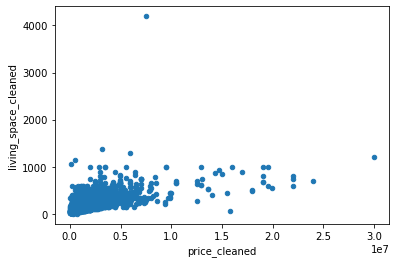

In [28]:
immoscout.plot.scatter(
    x = 'price_cleaned',
    y = 'living_space_cleaned'
)

In [12]:
immoscout.query('price_cleaned < 50000').sort_values(by = 'price_cleaned')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,gde_tax,gde_workers_sector1,gde_workers_sector2,gde_workers_sector3,gde_workers_total,price_cleaned,type,Space extracted,rooms,living_space_cleaned
10713,10713,Etoy,NaN,NaN,NaN,On request,"1163 Etoy, VD",«a vendre une maison villageoise sur la Côte»C...,DescriptionA vendre une maison villageoise sit...,https://www.immoscout24.ch//en/d/terrace-house...,...,8.37,95.0,393.0,2246.0,2734.0,1.0,terrace-house,NaN,NaN,NaN
3929,3929,Veyrier,140 m²,NaN,NaN,31.12.2022,"1255 Veyrier, GE","7 rooms, 140 m²«Villa a vendre 7 pieces a Veyr...",DescriptionJolie maison familliale comprenant ...,https://www.immoscout24.ch//en/d/detached-hous...,...,3.08,38.0,197.0,1870.0,2105.0,2.0,detached-house,140.0,7.0,140.0
5044,5044,Le Locle,45 m²,NaN,NaN,On request,"2400 Le Locle, NE","2 rooms, 45 m²«IDEAL POUR ETUDIANT !»CHF 745.—...","DescriptionIdéalement situé, cet appartement d...",https://www.immoscout24.ch//en/d/flat-buy-le-l...,...,9.98,83.0,5371.0,2812.0,8266.0,745.0,flat,45.0,2.0,45.0
10553,10553,Echandens,19 m²,NaN,NaN,15.09.2022,"1026 Echandens, VD","1 room, 19 m²«Magnifique chambre»CHF 950.—Favo...",DescriptionMagnifique chambre de 19m2 meublée ...,https://www.immoscout24.ch//en/d/single-room-b...,...,8.42,14.0,2668.0,13165.0,15847.0,950.0,single-room,19.0,1.0,19.0
12762,12762,Sion,66 m²,NaN,NaN,Immediately,"Route de Chippis 701967 Bramois, VS","2.5 rooms, 66 m²«UNIQUE A BRAMOIS ! Des 2.5 pc...","DescriptionNouveau projet ####CHIPPIS 70####, ...",https://www.immoscout24.ch//en/d/flat-buy-bram...,...,4.10,495.0,5673.0,27424.0,33592.0,1020.0,flat,66.0,2.5,66.0
4421,4421,Courtedoux,75 m²,NaN,NaN,On request,"Faubourg 1092905 Courtedoux, JU","3.5 rooms, 75 m²«Magnifique appartement à loue...",DescriptionMagnifique appartement dans un nouv...,https://www.immoscout24.ch//en/d/flat-buy-cour...,...,9.88,28.0,154.0,64.0,246.0,1100.0,flat,75.0,3.5,75.0
5049,5049,Le Locle,110 m²,NaN,NaN,On request,"2400 Le Locle, NE","5.5 rooms, 110 m²«MAGNIFIQUE PARQUET ANCIEN !»...",DescriptionBetterhomes vous propose ce magnifi...,https://www.immoscout24.ch//en/d/flat-buy-le-l...,...,9.98,83.0,5371.0,2812.0,8266.0,1275.0,flat,110.0,5.5,110.0
3637,3637,Lancy,NaN,NaN,NaN,On request,"Chemin des semailles 9c1212 Grand-Lancy, GE",«appartement 3 pièces»CHF 1600.—Favourite,DescriptionAppartement 3 pièces de 48m2 au 2èm...,https://www.immoscout24.ch//en/d/flat-buy-gran...,...,3.24,23.0,2072.0,17171.0,19266.0,1600.0,flat,NaN,NaN,NaN
10821,10821,Rolle,NaN,NaN,NaN,On request,"1180 Rolle, VD",3 rooms«appartement»CHF 1850.—Favourite,DescriptionAppartement - ROLLEOrientation oues...,https://www.immoscout24.ch//en/d/flat-buy-roll...,...,8.46,98.0,43.0,354.0,495.0,1850.0,flat,NaN,3.0,NaN
11381,11381,Montreux,NaN,NaN,NaN,On request,"1822 Chernex, VD",«-1-pièces-Appartement à Chernex»CHF 1850.—Fav...,DescriptionBel appartement situé près de Montr...,https://www.immoscout24.ch//en/d/flat-buy-cher...,...,8.56,72.0,1288.0,11020.0,12380.0,1850.0,flat,NaN,NaN,NaN


In [31]:
# immoscout.query('living_space_cleaned < 200 and price_cleaned > 15000000')
# immoscout.query('price_cleaned > 15000000')
immoscout.loc[10680].detailed_description

'DescriptionCette propriété de maître ####pieds dans l eau####, bénéficie d une situation exceptionnelle, privative et sécurisée, avec une vue plongeante et imprenable sur le lac et les montagnes.Construite en 2017 sur un terrain de 5 000 m², elle offre une conception contemporaine, des lignes architecturales modernes et des finitions d excellente qualité. Les équipements techniques et les matériaux de finition sont de très haut niveau et apportent un confort sans pareil.La propriété séduit par son élégance et sa décoration raffinée, toutes les pièces offrent un panorama sublime sur le lac Léman.Garage intérieur pour 10 voitures, salle de sport, salle de cinéma, tout est présent pour combler une clientèle exigeante.La maison se réparti sur 3 niveaux habitables. Elle comprend, au rez-de-chaussée, un espace de réception composé de deux salons ouverts sur une salle à manger et une grande cuisine divisée en deux parties, accueillant un espace repas et une zone de préparation-cuisson. Ce ni

In [24]:
immoscout.query('living_space_cleaned > 4000')

,Unnamed: 0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,price_cleaned,type,Space extracted,rooms,living_space_cleaned,canton,ZIP,city,street,house_nr
311,311,Villmergen,4193 m²,NaN,NaN,On request,"5612 Villmergen, AG","4193 m²«Bauland mit bewilligtem Projekt»CHF 7,...",DescriptionWillkommen im wunderschönen Aargau....,https://www.immoscout24.ch//en/d/flat-buy-vill...,...,7500000.0,flat,4193.0,NaN,4193.0,AG,5612,Villmergen,NaN,NaN


In [25]:
keywords =[
    'befristet',
    'helfen',
    'Baujahr',
    'Renovation nötig',
    'Renovierung nötig',
    'muss renoviert werden',
    'rohbau',
    'frisch renoviert',
    'Genossenschaft',
    'Renovationsbedürftig',
    'Mobile Home',
    'Tiny House',
    'Rustico',
    'Sanierung',
    'Bauland',
    'mieten'

]
for keyword in keywords:

    print(keyword, immoscout.detailed_description.str.contains(keyword).value_counts())


befristet False    13374
True         4
Name: detailed_description, dtype: int64
helfen False    13354
True        24
Name: detailed_description, dtype: int64
Baujahr False    12790
True       588
Name: detailed_description, dtype: int64
Renovation nötig False    13378
Name: detailed_description, dtype: int64
Renovierung nötig False    13378
Name: detailed_description, dtype: int64
muss renoviert werden False    13373
True         5
Name: detailed_description, dtype: int64
rohbau False    13375
True         3
Name: detailed_description, dtype: int64
frisch renoviert False    13354
True        24
Name: detailed_description, dtype: int64
Genossenschaft False    13375
True         3
Name: detailed_description, dtype: int64
Renovationsbedürftig False    13375
True         3
Name: detailed_description, dtype: int64
Mobile Home False    13377
True         1
Name: detailed_description, dtype: int64
Tiny House False    13375
True         3
Name: detailed_description, dtype: int64
Rustico False

In [ ]:
## parse floor



## split location




In [15]:
def oneHotEncoder(df=None, columns=None):
    '''
    df:
    Parent data frame

    columns:
    List of column names in a data frame that need to be encoded

    -----------------
    returns:
    encodedDf:
    Parent data frame with onehot encoded columns added
    '''
    encodedDf = df.copy()

    for column in columns:
        columnDf = df[column]
        for i in columnDf[0].unique():
            encodedDf.insert(len(encodedDf), i, 0, True)
            encodedDf[i] = columnDf[column] == i
            encodedDf[i] = encodedDf[i].replace({
                True: 1,
                False: 0
            })

        encodedDf.drop(column, axis=1)

    return encodedDf